In [111]:
# 라이브러리 업로드
import sys
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud
from pyecharts.charts import Map,Geo
from pyecharts import options as opts
from pyecharts.globals import ThemeType
import matplotlib.gridspec as gs

#plotly
import plotly as py
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from plotly.offline import download_plotlyjs,plot, iplot
import plotly.express as px
import plotly.graph_objects as go

#folium
import folium
import warnings
warnings.filterwarnings("ignore")

In [112]:
# covid19 데이터(data)
df= pd.read_csv('covid_19_data.csv')

In [113]:
df = df.rename(columns={'Country/Region':'Country'})
df = df.rename(columns={'ObservationDate':'Date'})
df

,SNo,Date,Province/State,Country,Last Update,Confirmed,Deaths,Recovered
0,1,01/22/2020,Anhui,Mainland China,1/22/2020 17:00,1.0,0.0,0.0
1,2,01/22/2020,Beijing,Mainland China,1/22/2020 17:00,14.0,0.0,0.0
2,3,01/22/2020,Chongqing,Mainland China,1/22/2020 17:00,6.0,0.0,0.0
3,4,01/22/2020,Fujian,Mainland China,1/22/2020 17:00,1.0,0.0,0.0
4,5,01/22/2020,Gansu,Mainland China,1/22/2020 17:00,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...
306424,306425,05/29/2021,Zaporizhia Oblast,Ukraine,2021-05-30 04:20:55,102641.0,2335.0,95289.0
306425,306426,05/29/2021,Zeeland,Netherlands,2021-05-30 04:20:55,29147.0,245.0,0.0
306426,306427,05/29/2021,Zhejiang,Mainland China,2021-05-30 04:20:55,1364.0,1.0,1324.0
306427,306428,05/29/2021,Zhytomyr Oblast,Ukraine,2021-05-30 04:20:55,87550.0,1738.0,83790.0


In [114]:
#데이터 전처리
df['Province/State'] = df['Province/State'].fillna("Unknown")

df = df.rename(columns = {"Province/State":"State"})
df = df.rename(columns = {"Country/Region":"Country"})
df[['Confirmed','Deaths','Recovered']] = df[['Confirmed','Deaths','Recovered']].astype(int)


#Active 칼럼 추가
df['Active'] = df['Confirmed']-df['Deaths']-df['Recovered']
df.head()

,SNo,Date,State,Country,Last Update,Confirmed,Deaths,Recovered,Active
0,1,01/22/2020,Anhui,Mainland China,1/22/2020 17:00,1,0,0,1
1,2,01/22/2020,Beijing,Mainland China,1/22/2020 17:00,14,0,0,14
2,3,01/22/2020,Chongqing,Mainland China,1/22/2020 17:00,6,0,0,6
3,4,01/22/2020,Fujian,Mainland China,1/22/2020 17:00,1,0,0,1
4,5,01/22/2020,Gansu,Mainland China,1/22/2020 17:00,0,0,0,0


In [55]:
#Plotly, Histogram - 나라 종류별 분포
fig = px.histogram(df,x = 'Country',
                   width=1000,height=None,
                   title = 'Covid-19 of Country')
fig.show()

In [54]:
#plotly - boxplot - 나라별 사망자 분포
fig = px.box(df, x = 'Country',
             y='Deaths',
             width=1000,height=None,
             title = 'Covid-19 Death of Country', color = 'Country')
fig.show()

In [8]:
#Plotly - 전세계 covid-19 통계 시각화
fig = go.Figure(data = [go.Table(
    header = dict(
        values = ['<b>Total Confirmed</b>','<b>Total Deaths</b>','<b>Total Recovered</b>','<b>Total Active Cases</b>'],
        line_color='black',
        fill_color= 'DarkRed',
        align='center',
        font=dict(color='white', size=12)
    ),
    cells = dict(
        values = [sum(df['Confirmed']),sum(df['Deaths']),sum(df['Recovered']),sum(df['Active'])],
        line_color='darkslategray',
        fill_color = 'white',
        font = dict(color = 'darkslategray', size = 11))
)])

fig.update_layout(title = 'Total Covid-19 ',
                  title_x = 0.5,
                  title_font = dict(size = 16, color = 'DarkRed'))

fig.show()

In [9]:
#Plotly- Pie사용 - 케이스 원인에 따른 코로나 분포
labels = ["Active Cases","Recovered Cases","Death Cases"]

sumactive= sum(df['Active'])
sumrecoverd = sum(df['Recovered'])
sumdeaths = sum(df['Deaths'])

fig = px.pie(df, 
             values = [sumactive,sumrecoverd,sumdeaths],
             names = labels,
             color_discrete_sequence = ['LightBlue','khaki','DarkCyan'])

fig.update_traces(textposition = 'inside', textinfo = 'percent+label')

fig.update_layout(title = 'World Covid-19 Various Cases',
                  title_x = 0.5,
                  title_font= dict(size = 18, color = 'MidnightBlue' ))

fig.show()

In [10]:
#Plotly bar - 일일 확진자 변화
df['Date'] = pd.to_datetime(df['Date'])
df = df.sort_values("Date")

dftime = df.groupby("Date")[["Confirmed","Active","Recovered","Deaths"]].sum().reset_index()

fig = px.bar(dftime,
             x = 'Date',
             y = 'Confirmed',
             color = 'Confirmed',
             color_continuous_scale = 'rdpu',
             labels = {"Confirmed":"Confirmed Cases"})

fig.update_layout(title = 'Daily confirmed cases',
                  title_x = 0.5,
                  title_font = dict(size= 18, color = 'DarkRed'),
                  xaxis = dict(title = 'Date'),
                  yaxis = dict(title = 'Confirmed Cases'))

fig.show()

Text(0.5, 1.0, 'Daily confirmed cases')

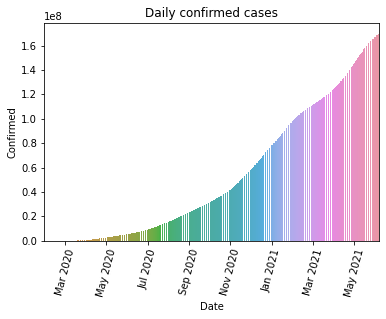

In [11]:
# Seaborn - 일일 확진자 변화
l = dftime["Date"].count()
plt.xticks(rotation=75)
bar = sns.barplot(data=dftime, x = 'Date', y = 'Confirmed')

bar.set(xticks=np.arange(l//16,l,l//8)) # x축 라벨 및 간격도 직접 조절해야 함 (안하면 완전 빼곡해서 못알아봄)
bar.set_xticklabels(['Mar 2020', 'May 2020', 'Jul 2020', 'Sep 2020', 'Nov 2020', 'Jan 2021', 'Mar 2021', 'May 2021'])
bar.set_title("Daily confirmed cases") # 한국어가 안됨

In [12]:
#Plotly bar- 일일 완치자 변화
fig = px.bar(dftime,
             x = 'Date',
             y = 'Recovered',
             color = 'Recovered',
             color_continuous_scale = 'greens',
             labels = {"Recovered":"Recovered Cases"})

fig.update_layout(title = '"Daily Recovered cases',
                  title_x = 0.5,
                  title_font = dict(size= 18, color = 'DarkCyan'),
                  xaxis = dict(title = 'Date'),
                  yaxis = dict(title = 'Recovered Cases'))

fig.show()

In [13]:
#Plotly bar- 일일 사망자 변화
fig = px.bar(dftime,
             x = 'Date',
             y = 'Deaths',
             color = 'Deaths',
             color_continuous_scale = 'gray',
             labels = {"Deaths":"Death Caaes"})

fig.update_layout(title = '"Daily Death cases',
                  title_x = 0.5,
                  title_font = dict(size= 18, color = 'DarkSlateGray'),
                  xaxis = dict(title = 'Date'),
                  yaxis = dict(title = 'Death Cases'))

fig.show()

In [14]:
#Plotly bar- 상위30개 확진된 나라 분포 시각화
df1 = df.groupby("Country")["Confirmed"].sum().sort_values(ascending = False).reset_index().head(30)
fig = px.bar(df1,
             x = 'Country',
             y = 'Confirmed',
             color = 'Confirmed',
             color_continuous_scale = 'rainbow',
             labels = {"Confirmed":"Confirmed Cases"})

fig.update_layout(title = 'Top 30 Confirmed Cases of Country',
                  title_x = 0.5,
                  title_font = dict(size = 18, color = 'black'),
                  yaxis = dict(title = 'Confirmed Cases'),
                  xaxis = dict(tickangle = 45))
fig.show()


In [15]:
#Plotly bar- 상위30개 완치자가 많은 순위 분포 시각화
df2 = df.groupby("Country")["Recovered"].sum().sort_values(ascending = False).reset_index().head(30)
fig = px.bar(df2,
             x = 'Country',
             y = 'Recovered',
             color = 'Recovered',
             color_continuous_scale = 'rainbow',
             labels = {"Confirmed":"Recovered Cases"})

fig.update_layout(title = 'Top 30 Recovered Cases of Country',
                  title_x = 0.5,
                  title_font = dict(size = 18, color = 'Black'),
                  yaxis = dict(title = 'Recovered Cases'),
                  xaxis = dict(tickangle = 45))

fig.show()

In [16]:
# 나라별 확진자 누적 합계 데이터(countries) 
df_countries = df.groupby(['Country', 'Date']).sum().reset_index().sort_values('Date', ascending=True)
df_countries = df_countries.drop_duplicates(subset = ['Country'])
df_countries = df_countries[df_countries['Confirmed']>0]
df_countries

,Country,Date,SNo,Confirmed,Deaths,Recovered,Active
78450,Thailand,2020-01-22,37,4,0,2,2
77121,Taiwan,2020-01-22,29,1,0,0,1
48373,Mainland China,2020-01-22,535,547,17,28,502
47443,Macau,2020-01-22,21,1,0,0,1
81663,US,2020-01-22,32,1,0,0,1
...,...,...,...,...,...,...,...
44396,Lesotho,2020-05-13,24559,1,0,0,1
71848,Solomon Islands,2020-10-12,131265,2,0,0,2
51110,Marshall Islands,2020-10-28,143193,2,0,0,2
84415,Vanuatu,2020-11-10,152994,1,0,0,1


In [17]:
# <Plotly - Map : 최근 확진자수 시각화>
fig = go.Figure(data=go.Choropleth(
    locations = df_countries['Country'], # 나라 이름 column
    locationmode = 'country names', #locationmode = worldwide 
    z = df_countries['Confirmed'], # 확진자 수 column
    colorscale = 'aggrnyl',
    marker_line_color = 'black',
    marker_line_width = 0.4,
))

import datetime
date = df.sort_values('Date',ascending = False).reset_index()['Date'][0]

fig.update_layout(
    title_text = 'World-Wide Confirmed Cases Distribution Map ',
    title_x = 0.5,
    geo=dict(
        showframe = False,
        showcoastlines = False,
        projection_type = 'equirectangular'
    )
)


In [ ]:
# # <Plotly - Map 시각의 흐름에 따라 변화하는 일별 확진자 수 시각화>

# df_countrydate = df[df['Confirmed']>0]
# df_countrydate = df_countrydate.groupby(['Date','Country']).sum().reset_index()

# # Creating the visualization
# fig = px.choropleth(df_countrydate, 
#                     locations="Country", # 나라 이름 column
#                     locationmode = "country names", 
#                     color="Confirmed", # 일별 누적 확진자
#                     hover_name="Country", # 마우스 커서 위치 시, 표기되는 이름
#                     animation_frame="Date"
#                    )
# fig.update_layout(
#     title_text = 'World-Wide Confirmed Cases Changes',
#     title_x = 0.5,
#     geo=dict(
#         showframe = False,
#         showcoastlines = False,
#     ))
    
# fig.show()

In [21]:
df_countrydate = df[df['Confirmed']>0]
df_countrydate = df_countrydate.groupby(['Date','Country']).sum().reset_index()

#한국 데이터만 뽑기(df_Korea)
df_Korea = df[(df['Country'] == 'South Korea') ].reset_index()
df_Korea

,index,SNo,Date,State,Country,Last Update,Confirmed,Deaths,Recovered,Active
0,37,38,2020-01-22,Unknown,South Korea,1/22/2020 17:00,1,0,0,1
1,77,78,2020-01-23,Unknown,South Korea,1/23/20 17:00,1,0,0,1
2,125,126,2020-01-24,Unknown,South Korea,1/24/20 17:00,2,0,0,2
3,168,169,2020-01-25,Unknown,South Korea,1/25/20 17:00,2,0,0,2
4,216,217,2020-01-26,Unknown,South Korea,1/26/20 16:00,3,0,0,3
...,...,...,...,...,...,...,...,...,...,...
489,302749,302750,2021-05-25,Unknown,South Korea,2021-05-26 04:20:35,137682,1940,127582,8160
490,303514,303515,2021-05-26,Unknown,South Korea,2021-05-27 04:20:59,138311,1943,128180,8188
491,304279,304280,2021-05-27,Unknown,South Korea,2021-05-28 04:20:36,138898,1946,128761,8191
492,305044,305045,2021-05-28,Unknown,South Korea,2021-05-29 04:20:41,139431,1951,129739,7741


In [22]:
#한국 통계량만 따로 뽑음
fig = go.Figure(data = [go.Table(
    header = dict(
        values = ['<b>Total Confirmed</b>','<b>Total Deaths</b>','<b>Total Recovered</b>','<b>Total Active Cases</b>'],
        line_color='darkslategray',
        fill_color= 'DarkRed',
        align='center',
        font=dict(color='white', size=12)
    ),
    cells = dict(
        values = [sum(df_Korea['Confirmed']),sum(df_Korea['Deaths']),sum(df_Korea['Recovered']),sum(df_Korea['Active'])],
        line_color='darkslategray',
        fill_color = 'white',
        font = dict(color = 'darkslategray', size = 12))
)])

fig.update_layout(title = 'Korea - Covid-19 Cases',
                  title_x = 0.5,
                  title_font = dict(size = 18, color = 'DarkRed'))

fig.show()

In [25]:
labels = ["Active Cases","Recovered Cases","Deaths"]

sumactive= sum(df_Korea['Active'])
sumrecoverd = sum(df_Korea['Recovered'])
sumdeaths = sum(df_Korea['Deaths'])

fig = px.pie(df, 
             values = [sumactive,sumrecoverd,sumdeaths],
             names = labels,
             color_discrete_sequence = ['lightblue','khaki','lightcoral'])

fig.update_traces(textposition = 'inside', textinfo = 'percent+label')
fig.update_layout(title = 'Korea Covid-19 Various Cases Chart ',
                  title_x = 0.45,
                  title_font= dict(size = 18, color = 'black' ))

fig.show()


In [26]:
#Plotly- Scatter 사용
Data_Korea= df_Korea.groupby("Date")["Confirmed","Deaths","Recovered","Active"].sum().reset_index().sort_values("Date").reset_index()

fig = go.Figure()

fig.add_trace(go.Scatter(x=Data_Korea['Date'], 
                         y=Data_Korea['Confirmed'],
                         mode='lines',
                         name='Confirmed Cases',
                         marker_color='purple'))

fig.add_trace(go.Scatter(x=Data_Korea['Date'], 
                         y=Data_Korea['Active'],
                         mode='lines',
                         name='Active Cases',
                         marker_color='RoyalBlue',
                         line=dict( dash='dot')))

fig.add_trace(go.Scatter(x=Data_Korea['Date'], 
                         y=Data_Korea['Deaths'],
                         name='Death Cases',
                         marker_color='DarkSlateGray',
                         mode='lines',
                         line=dict( dash='dot') ))

fig.add_trace(go.Scatter(x=Data_Korea['Date'], 
                         y=Data_Korea['Recovered'],
                         mode='lines',
                         name='Recovered Cases',
                         marker_color='green'))

fig.update_layout(title='Korea Covid-19 Case TimeLine',
                  title_x = 0.5,
                  title_font = dict(size = 18, color = 'DarkRed'),
                  template='plotly_white')

fig.show()


In [28]:
tmp1 = pd.DataFrame(Data_Korea[['Date', 'Confirmed']])
tmp1["category"] = "Confirmed"
tmp1 = tmp1.rename(columns={'Confirmed':'Count'})
tmp2 = pd.DataFrame(Data_Korea[['Date', 'Active']])
tmp2["category"] = 'Active'
tmp2 = tmp2.rename(columns={'Active':'Count'})
tmp3 = pd.DataFrame(Data_Korea[['Date', 'Deaths']])
tmp3["category"] = 'Deaths'
tmp3 = tmp3.rename(columns={'Deaths':'Count'})
tmp4 = pd.DataFrame(Data_Korea[['Date', 'Recovered']])
tmp4["category"] = 'Recovered'
tmp4 = tmp4.rename(columns={'Recovered':'Count'})
ldata = pd.concat([tmp1, tmp2, tmp3, tmp4])
print(ldata)

          Date   Count   category
0   2020-01-22       1  Confirmed
1   2020-01-23       1  Confirmed
2   2020-01-24       2  Confirmed
3   2020-01-25       2  Confirmed
4   2020-01-26       3  Confirmed
..         ...     ...        ...
489 2021-05-25  127582  Recovered
490 2021-05-26  128180  Recovered
491 2021-05-27  128761  Recovered
492 2021-05-28  129739  Recovered
493 2021-05-29  130381  Recovered

[1976 rows x 3 columns]


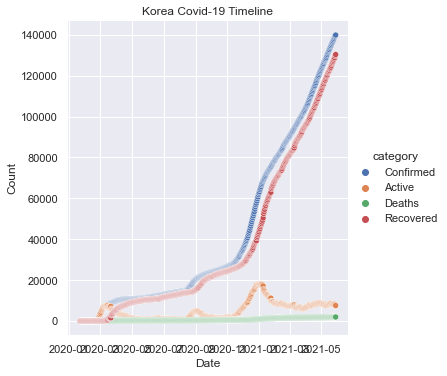

In [41]:
sns.relplot(data=ldata, x="Date", y="Count", hue="category")
plt.title("Korea Covid-19 Timeline")
rcParams['figure.figsize'] = 20,8

In [49]:
#Plotly, Scatter사용 
import plotly.express as px

covid_countries = df.groupby(['Country'], sort = False)['Confirmed', 'Deaths'].max()
top10 = covid_countries.sort_values('Confirmed', ascending = False)[:15]
fig = px.scatter(top10,
                x = top10.index,
                y = 'Confirmed',
                size = 'Deaths',
                color = top10.index,
                template = 'xgridoff',
                title = 'TOP 10 Covid-19 Country & Confirmed Cases')
fig.show()

In [75]:
#Plotly 산점도 매트릭스 - 한국 데이터만
fig = px.scatter_matrix(df_Korea, dimensions=['Deaths', 'Active', "Recovered"], color="Confirmed")
fig.show()

In [150]:
#Plotly Scatter - Bubble Chart 
#나라 : <미국> #한국은 State정보가 없어서 선택안함
fig = px.scatter(df.query("Country=='US'"), x="Confirmed", y="Deaths", size="Confirmed", color="State",
           hover_name="Active", log_x=True, size_max=60)
        
fig.show()	